In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
# from shapely.geometry import Point
from scipy.stats import zscore, t
from scipy import stats
import plotly.express as px

In [ ]:
#Read file
data = pd.read_csv("./crypto-markets.csv")

In [ ]:
# Show first few lines of data frame
print(data.head())

      slug symbol     name        date  ranknow    open    high     low  \
0  bitcoin    BTC  Bitcoin  2013-04-28        1  135.30  135.98  132.10   
1  bitcoin    BTC  Bitcoin  2013-04-29        1  134.44  147.49  134.00   
2  bitcoin    BTC  Bitcoin  2013-04-30        1  144.00  146.93  134.05   
3  bitcoin    BTC  Bitcoin  2013-05-01        1  139.00  139.89  107.72   
4  bitcoin    BTC  Bitcoin  2013-05-02        1  116.38  125.60   92.28   

    close  volume        market  close_ratio  spread  
0  134.21     0.0  1.488567e+09       0.5438    3.88  
1  144.54     0.0  1.603769e+09       0.7813   13.49  
2  139.00     0.0  1.542813e+09       0.3843   12.88  
3  116.99     0.0  1.298955e+09       0.2882   32.17  
4  105.21     0.0  1.168517e+09       0.3881   33.32  


In [ ]:
# 'slug'と'name'を取り除く
data_cleaned = data.drop(columns=['slug', 'name'])
# データの先頭を表示
print(data_cleaned.head())

  symbol        date  ranknow    open    high     low   close  volume  \
0    BTC  2013-04-28        1  135.30  135.98  132.10  134.21     0.0   
1    BTC  2013-04-29        1  134.44  147.49  134.00  144.54     0.0   
2    BTC  2013-04-30        1  144.00  146.93  134.05  139.00     0.0   
3    BTC  2013-05-01        1  139.00  139.89  107.72  116.99     0.0   
4    BTC  2013-05-02        1  116.38  125.60   92.28  105.21     0.0   

         market  close_ratio  spread  
0  1.488567e+09       0.5438    3.88  
1  1.603769e+09       0.7813   13.49  
2  1.542813e+09       0.3843   12.88  
3  1.298955e+09       0.2882   32.17  
4  1.168517e+09       0.3881   33.32  


In [ ]:
# Count the number of unique values for 'symbol' column
symbol_counts = data_cleaned['symbol'].value_counts()
# Show results
print(symbol_counts)

symbol
BITS     3189
PXC      2123
BTB      2049
BTM      2043
LTC      2042
         ... 
STACS       3
BCDT        2
ATP         2
BEAT        2
BTNT        2
Name: count, Length: 2005, dtype: int64


In [ ]:
# Count the number of unique values for 'symbol' column
unique_symbol_count = data_cleaned['symbol'].nunique()
# Show results
print(f"Number of unique symbols: {unique_symbol_count}")

ユニークなシンボルの数: 57


In [ ]:
# Calculate the 5th percentile of Close value for each virtual currency
percentile_5 = data_cleaned.groupby('symbol')['close'].quantile(0.05)
# Filter rows below the 5th percentile
filtered_data = data_cleaned[data_cleaned.apply(lambda row: row['close'] >= percentile_5[row['symbol']], axis=1)]
# Show results
print(f"Data frame after applying the lower 5% threshold:")
print(filtered_data.head())
# Display statistics
print(f"Number of rows in original data frame: {data_cleaned.shape[0]}")
print(f"Number of rows in data frame after filtering: {filtered_data.shape[0]}")

下位5%の閾値を適用した後のデータフレーム:
   symbol        date  ranknow    open    high     low   close  volume  \
0     BTC  2013-04-28        1  135.30  135.98  132.10  134.21     0.0   
1     BTC  2013-04-29        1  134.44  147.49  134.00  144.54     0.0   
2     BTC  2013-04-30        1  144.00  146.93  134.05  139.00     0.0   
19    BTC  2013-05-17        1  118.21  125.30  116.57  123.01     0.0   
20    BTC  2013-05-18        1  123.50  125.25  122.30  123.50     0.0   

          market  close_ratio  spread  
0   1.488567e+09       0.5438    3.88  
1   1.603769e+09       0.7813   13.49  
2   1.542813e+09       0.3843   12.88  
19  1.373724e+09       0.7377    8.73  
20  1.379575e+09       0.4068    2.95  
元のデータフレームの行数: 46425
フィルタリング後のデータフレームの行数: 44114


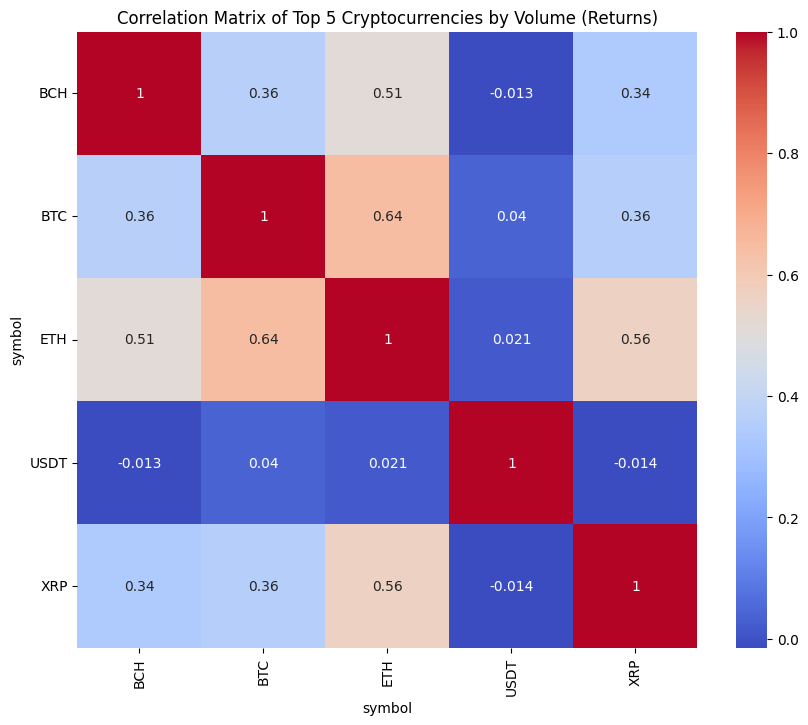

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
# Load data
data = pd.read_csv("./crypto-markets.csv")
# Remove 'slug' and 'name
data_cleaned = data.drop(columns=['slug', 'name'])
# Calculate total volume of transactions for each virtual currency
total_volume = data_cleaned.groupby('symbol')['volume'].sum()
# Identify the top 5 virtual currencies with the highest trading volume
top_5_symbols = total_volume.nlargest(5).index
# Filter data for top 5 virtual currencies
top_5_data = data_cleaned[data_cleaned['symbol'].isin(top_5_symbols)]
# Convert Close values of top 5 virtual currencies into a pivot table
close_data = top_5_data.pivot_table(index='date', columns='symbol', values='close', aggfunc='last')
# Convert date index to datetime type
close_data.index = pd.to_datetime(close_data.index)
# Extract only numerical data and process missing values by forward filling
numeric_close_data = close_data.apply(pd.to_numeric, errors='coerce').fillna(method='ffill')
# Calculate rate of change (return)
returns_data = numeric_close_data.pct_change().dropna()
# Calculate correlation matrix for rate of change
correlation_matrix = returns_data.corr()
# Create heat map
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', xticklabels=correlation_matrix.columns, yticklabels=correlation_matrix.columns)
plt.title('Correlation Matrix of Top 5 Cryptocurrencies by Volume (Returns)')
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

In [ ]:
# Count the number of unique values for 'symbol' column
unique_symbol_count = data_cleaned['symbol'].nunique()
# Show results
print(f"Number of unique symbols: {unique_symbol_count}")

ユニークなシンボルの数: 57


In [ ]:
# Display the basic information about the dataset
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 942297 entries, 0 to 942296
Data columns (total 13 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   slug         942297 non-null  object 
 1   symbol       942297 non-null  object 
 2   name         942297 non-null  object 
 3   date         942297 non-null  object 
 4   ranknow      942297 non-null  int64  
 5   open         942297 non-null  float64
 6   high         942297 non-null  float64
 7   low          942297 non-null  float64
 8   close        942297 non-null  float64
 9   volume       942297 non-null  float64
 10  market       942297 non-null  float64
 11  close_ratio  942297 non-null  float64
 12  spread       942297 non-null  float64
dtypes: float64(8), int64(1), object(4)
memory usage: 93.5+ MB
None


In [ ]:
# Generate descriptive statistics
description = data.describe()
description

,ranknow,open,high,low,close,volume,market,close_ratio,spread
count,942297.000000,9.422970e+05,9.422970e+05,9.422970e+05,9.422970e+05,9.422970e+05,9.422970e+05,942297.000000,9.422970e+05
mean,1000.170608,3.483522e+02,4.085930e+02,2.962526e+02,3.461018e+02,8.720383e+06,1.725060e+08,0.459499,1.123400e+02
std,587.575283,1.318436e+04,1.616386e+04,1.092931e+04,1.309822e+04,1.839802e+08,3.575590e+09,0.326160,6.783713e+03
min,1.000000,2.500000e-09,3.200000e-09,2.500000e-10,2.000000e-10,0.000000e+00,0.000000e+00,-1.000000,0.000000e+00
25%,465.000000,2.321000e-03,2.628000e-03,2.044000e-03,2.314000e-03,1.750000e+02,2.958100e+04,0.162900,0.000000e+00
50%,1072.000000,2.398300e-02,2.680200e-02,2.143700e-02,2.389200e-02,4.278000e+03,5.227960e+05,0.432400,0.000000e+00
75%,1484.000000,2.268600e-01,2.508940e-01,2.043910e-01,2.259340e-01,1.190900e+05,6.874647e+06,0.745800,3.000000e-02
max,2072.000000,2.298390e+06,2.926100e+06,2.030590e+06,2.300740e+06,2.384090e+10,3.265025e+11,1.000000,1.770563e+06


In [ ]:
# Check for missing values
missing_values = data.isnull().sum()
print(missing_values)

slug           0
symbol         0
name           0
date           0
ranknow        0
open           0
high           0
low            0
close          0
volume         0
market         0
close_ratio    0
spread         0
dtype: int64


In [ ]:
# Check for duplicate rows
duplicates = data.duplicated().sum()
print(f"Number of duplicate rows: {duplicates}")

Number of duplicate rows: 0


In [ ]:
# Check for inconsistent data types
print(data.dtypes)

slug            object
symbol          object
name            object
date            object
ranknow          int64
open           float64
high           float64
low            float64
close          float64
volume         float64
market         float64
close_ratio    float64
spread         float64
dtype: object


In [ ]:
# Check for negative values in columns where it doesn't make sense
negative_values = data[data[['open', 'high', 'low', 'close', 'volume', 'market']] < 0].sum()
print(f"Negative values:\n{negative_values}")

Negative values:
slug             0
symbol           0
name             0
date             0
ranknow        0.0
open           0.0
high           0.0
low            0.0
close          0.0
volume         0.0
market         0.0
close_ratio    0.0
spread         0.0
dtype: object


In [ ]:
# Check for abnormal values (use quartile range to detect abnormal values)
def detect_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[column] < lower_bound) | (df[column] > upper_bound)]

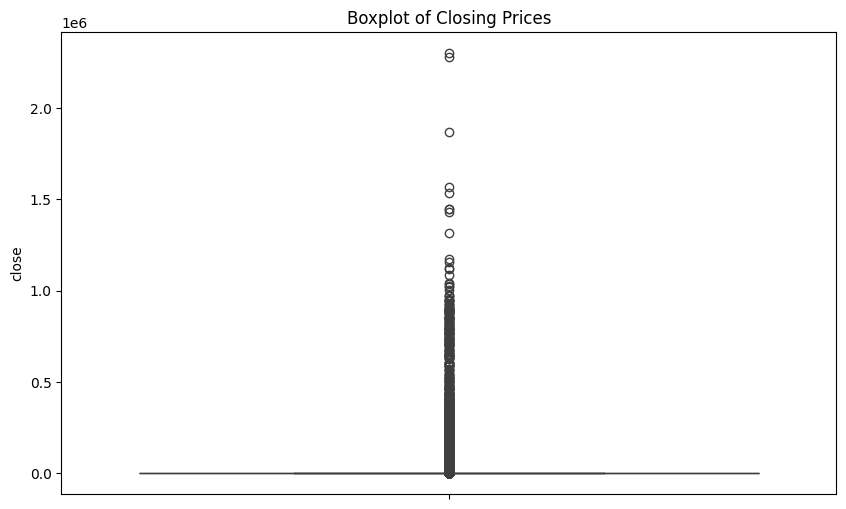

In [ ]:
# Visualize distributions to check for outliers
plt.figure(figsize=(10, 6))
sns.boxplot(data['close'])
plt.title('Boxplot of Closing Prices')
plt.show()

In [ ]:
fig1 = px.line(data[data['name'] == 'Bitcoin'], x='date', y='close', title='Bitcoin Closing Price Over Time')
fig1.show()

In [ ]:
fig2 = px.line(data[data['name'] == 'Bitcoin'], x='date', y='volume', title='Bitcoin Trading Volume Over Time')
fig2.show()

In [ ]:
fig3 = px.line(data, x='date', y='market', color='name', title='Market Cap of Different Cryptocurrencies Over Time')
fig3.show()

In [ ]:
# Check for duplicate 'slug' columns
duplicates_slug = data['slug'].duplicated()

# Show if there are duplicates in the 'slug' column
print("Number of duplicate 'slug' values:", duplicates_slug.sum())

# Show details of duplicate rows in 'slug' column
print(data[duplicates_slug])


Number of duplicate 'slug' values: 940226
             slug symbol       name        date  ranknow      open      high  \
1         bitcoin    BTC    Bitcoin  2013-04-29        1    134.44    147.49   
2         bitcoin    BTC    Bitcoin  2013-04-30        1    144.00    146.93   
3         bitcoin    BTC    Bitcoin  2013-05-01        1    139.00    139.89   
4         bitcoin    BTC    Bitcoin  2013-05-02        1    116.38    125.60   
5         bitcoin    BTC    Bitcoin  2013-05-03        1    106.25    108.13   
...           ...    ...        ...         ...      ...       ...       ...   
942292  project-x  NANOX  Project-X  2018-11-26     1727  22424.60  23049.30   
942293  project-x  NANOX  Project-X  2018-11-27     1727  20711.90  23742.10   
942294  project-x  NANOX  Project-X  2018-11-28     1727  23320.90  25235.10   
942295  project-x  NANOX  Project-X  2018-11-29     1727  24543.53  24582.47   
942296  project-x  NANOX  Project-X  2018-11-30     1727  22872.09  23086.98  

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


# Convert Close value of each virtual currency to a pivot table
close_data = data.pivot_table(index='date', columns='symbol', values='close', aggfunc='last')

# Convert date index to datetime type
close_data.index = pd.to_datetime(close_data.index)

# Extract only numerical data and process missing values by forward filling
numeric_close_data = close_data.apply(pd.to_numeric, errors='coerce').fillna(method='ffill')

# Calculate the correlation matrix
correlation_matrix = numeric_close_data.corr()

# Create heat map
plt.figure(figsize=(16, 12))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', xticklabels=correlation_matrix.columns, yticklabels=correlation_matrix.columns)
plt.title('Correlation Matrix of Cryptocurrencies')
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()


In [ ]:
# Convert 'date' to datetime format
data['date'] = pd.to_datetime(data['date'])

# Convert closing price of each cryptocurrency to pivot table format
pivot_table = data.pivot(index='date', columns='name', values='close')

# Display the first few rows to see the structure of the pivot table
print(pivot_table.head())

# Check for lines containing NaN
nan_rows = pivot_table[pivot_table.isna().any(axis=1)]
print("Rows with NaN values:")
print(nan_rows)

name        0chain  0x  0xBitcoin  0xcert  1World  2GIVE  300 Token  42-coin  \
date                                                                           
2013-04-28     NaN NaN        NaN     NaN     NaN    NaN        NaN      NaN   
2013-04-29     NaN NaN        NaN     NaN     NaN    NaN        NaN      NaN   
2013-04-30     NaN NaN        NaN     NaN     NaN    NaN        NaN      NaN   
2013-05-01     NaN NaN        NaN     NaN     NaN    NaN        NaN      NaN   
2013-05-02     NaN NaN        NaN     NaN     NaN    NaN        NaN      NaN   

name        4NEW  808Coin  ...  imbrex  indaHash  nDEX  nUSD  savedroid  \
date                       ...                                            
2013-04-28   NaN      NaN  ...     NaN       NaN   NaN   NaN        NaN   
2013-04-29   NaN      NaN  ...     NaN       NaN   NaN   NaN        NaN   
2013-04-30   NaN      NaN  ...     NaN       NaN   NaN   NaN        NaN   
2013-05-01   NaN      NaN  ...     NaN       NaN   NaN   NaN    

In [ ]:
# Extract bitcoin data
btc_data = data[data['name'] == 'Bitcoin'].copy()

# Calculate daily returns
btc_data.loc[:, 'daily_return'] = btc_data['close'].pct_change()

# Calculate Total Return
total_return = (btc_data['close'].iloc[-1] / btc_data['close'].iloc[0] - 1) * 100

# Calculate Daily Sharpe Ratio
risk_free_rate = 0.042 / 365  # Convert 4.2% per annum to daily
sharpe_ratio = (btc_data['daily_return'].mean() - risk_free_rate) / btc_data['daily_return'].std() * np.sqrt(365)

# Calculate Daily Sortino Ratio
downside_return = btc_data[btc_data['daily_return'] < 0]['daily_return']
sortino_ratio = (btc_data['daily_return'].mean() - risk_free_rate) / downside_return.std() * np.sqrt(365)

# Calculate CAGR
years = (pd.to_datetime(btc_data['date']).iloc[-1] - pd.to_datetime(btc_data['date']).iloc[0]).days / 365.25
cagr = ((btc_data['close'].iloc[-1] / btc_data['close'].iloc[0]) ** (1 / years) - 1) * 100

# Calculate Max Drawdown
cumulative_return = (1 + btc_data['daily_return']).cumprod()
peak = cumulative_return.cummax()
drawdown = (cumulative_return - peak) / peak
max_drawdown = drawdown.min() * 100

# Calculate Calmar Ratio
calmar_ratio = cagr / abs(max_drawdown)

# Mean
mean_close = np.mean(data[data['name'] == 'Bitcoin']['close'])

# Standard deviation
std_close = np.std(data[data['name'] == 'Bitcoin']['close'])

# Display Results
print(f"Total Return: {total_return:.2f}%")
print(f"Daily Sharpe Ratio: {sharpe_ratio:.2f}")
print(f"Daily Sortino Ratio: {sortino_ratio:.2f}")
print(f"CAGR: {cagr:.2f}%")
print(f"Max Drawdown: {max_drawdown:.2f}%")
print(f"Calmar Ratio: {calmar_ratio:.2f}")
print(f"Mean: {mean_close:.2f}")
print(f"Standard Deviation: {std_close:.2f}")


Total Return: 3088.18%
Daily Sharpe Ratio: 1.10
Daily Sortino Ratio: 1.44
CAGR: 85.81%
Max Drawdown: -84.53%
Calmar Ratio: 1.02
Mean: 2287.29
Standard Deviation: 3437.52


<ipython-input-38-78f927a72251>:76: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Crypto', y=metric, data=results_df, ax=axs[i//2, i%2], palette=colors)
<ipython-input-38-78f927a72251>:76: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Crypto', y=metric, data=results_df, ax=axs[i//2, i%2], palette=colors)
<ipython-input-38-78f927a72251>:76: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Crypto', y=metric, data=results_df, ax=axs[i//2, i%2], palette=colors)
<ipython-input-38-78f927a72251>:76: FutureWarning: 

Passing `palette` without 

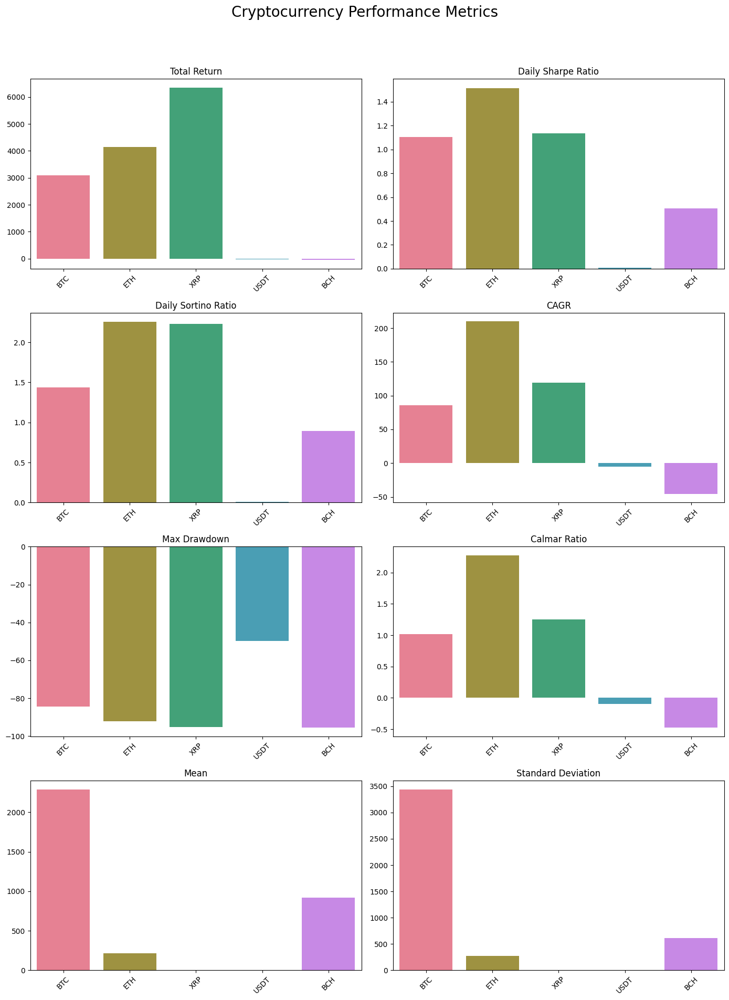

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load data
data = pd.read_csv("/content/crypto-markets.csv")

# List of virtual currencies to be calculated
cryptos = ['BTC', 'ETH', 'XRP', 'USDT', 'BCH']

# Set risk-free rate
risk_free_rate = 0.042 / 365  # 年率4.2%を日次に変換

# List to store indicators
results = []

for crypto in cryptos:
    # Extract virtual currency data
    crypto_data = data[data['symbol'] == crypto].copy()

    # Calculate daily returns
    crypto_data['daily_return'] = crypto_data['close'].pct_change()

    # Calculate total return
    total_return = (crypto_data['close'].iloc[-1] / crypto_data['close'].iloc[0] - 1) * 100

    # Calculate Sharpe Ratio
    sharpe_ratio = (crypto_data['daily_return'].mean() - risk_free_rate) / crypto_data['daily_return'].std() * np.sqrt(365)

    # Soltino ratio calculation
    downside_return = crypto_data[crypto_data['daily_return'] < 0]['daily_return']
    sortino_ratio = (crypto_data['daily_return'].mean() - risk_free_rate) / downside_return.std() * np.sqrt(365)

    # Calculate CAGR
    years = (pd.to_datetime(crypto_data['date']).iloc[-1] - pd.to_datetime(crypto_data['date']).iloc[0]).days / 365.25
    cagr = ((crypto_data['close'].iloc[-1] / crypto_data['close'].iloc[0]) ** (1 / years) - 1) * 100

    # Calculate maximum drawdown
    cumulative_return = (1 + crypto_data['daily_return']).cumprod()
    peak = cumulative_return.cummax()
    drawdown = (cumulative_return - peak) / peak
    max_drawdown = drawdown.min() * 100

    # Calculate Kalmar ratio
    calmar_ratio = cagr / abs(max_drawdown)

    # Calculate mean and standard deviation
    mean_close = np.mean(crypto_data['close'])
    std_close = np.std(crypto_data['close'])

    # Add results to list
    results.append({
        'Crypto': crypto,
        'Total Return': total_return,
        'Daily Sharpe Ratio': sharpe_ratio,
        'Daily Sortino Ratio': sortino_ratio,
        'CAGR': cagr,
        'Max Drawdown': max_drawdown,
        'Calmar Ratio': calmar_ratio,
        'Mean': mean_close,
        'Standard Deviation': std_close
    })

# Convert to data frame
results_df = pd.DataFrame(results)

# Plot the indicators
fig, axs = plt.subplots(4, 2, figsize=(14, 20))
fig.suptitle('Cryptocurrency Performance Metrics', fontsize=20)

metrics = ['Total Return', 'Daily Sharpe Ratio', 'Daily Sortino Ratio', 'CAGR', 'Max Drawdown', 'Calmar Ratio', 'Mean', 'Standard Deviation']
colors = sns.color_palette("husl", len(cryptos))
for i, metric in enumerate(metrics):
    sns.barplot(x='Crypto', y=metric, data=results_df, ax=axs[i//2, i%2], palette=colors)
    axs[i//2, i%2].set_title(metric)
    axs[i//2, i%2].set_xlabel('')
    axs[i//2, i%2].set_ylabel('')
    axs[i//2, i%2].tick_params(axis='x', rotation=45)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

In [ ]:
# Plot the Sharpe ratios of the portfolio assets
sharpe_ratio.plot.bar(title="Sharpe Ratios of Portfolio Assets")

AttributeError: 'numpy.float64' object has no attribute 'plot'

<ipython-input-13-1a48c6bc0401>:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  btc_data[f'lag_{i}'] = btc_data['close'].shift(i)
<ipython-input-13-1a48c6bc0401>:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  btc_data[f'lag_{i}'] = btc_data['close'].shift(i)
<ipython-input-13-1a48c6bc0401>:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org

Mean Squared Error: 1559003.78641515
Root Mean Squared Error: 1248.6007313849973
Normalized RMSE: 0.1572182457071482
Accuracy: 84.27817542928517%


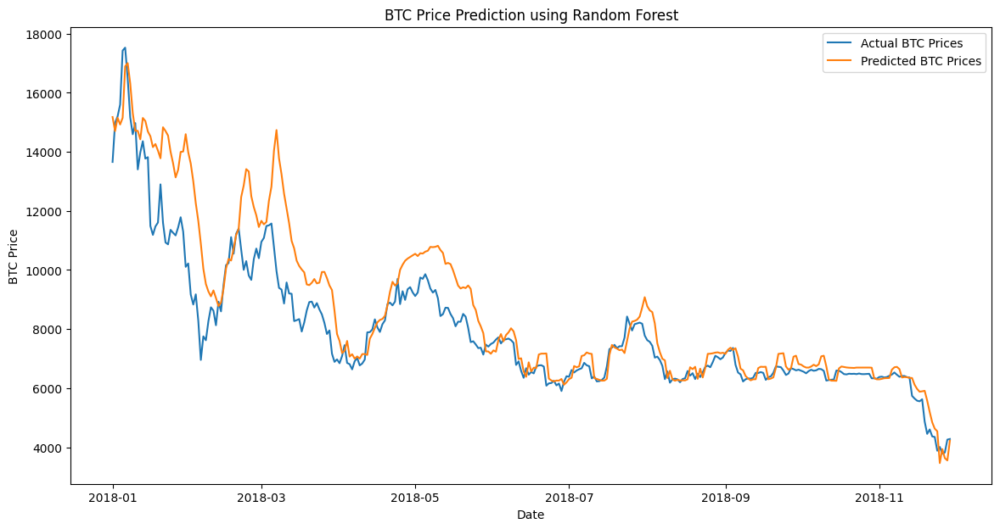

In [ ]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt

# Load data
data = pd.read_csv("./crypto-markets.csv")

# Remove 'slug' and 'name
data_cleaned = data.drop(columns=['slug', 'name'])

# Convert date index to datetime type
data_cleaned['date'] = pd.to_datetime(data_cleaned['date'])

# Extract only BTC data
btc_data = data_cleaned[data_cleaned['symbol'] == 'BTC']

# Create features (as an example, use prices over the past 7 days as features)
for i in range(1, 8):
    btc_data[f'lag_{i}'] = btc_data['close'].shift(i)

# Remove missing values
btc_data = btc_data.dropna()

# Split into training and testing periods
train_data = btc_data[(btc_data['date'] >= '2013-04-28') & (btc_data['date'] <= '2017-12-31')]
test_data = btc_data[(btc_data['date'] >= '2018-01-01') & (btc_data['date'] <= '2018-11-30')]

# Define features and targets
X_train = train_data[[f'lag_{i}' for i in range(1, 8)]]
y_train = train_data['close']
X_test = test_data[[f'lag_{i}' for i in range(1, 8)]]
y_test = test_data['close']

# Random Forest Model Definition and Training
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Predictions for test set
y_pred = model.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
nrmse = rmse / y_test.mean()  # Normalized RMSE

# Calculate accuracy
accuracy = 100 * (1 - nrmse)

print(f'Mean Squared Error: {mse}')
print(f'Root Mean Squared Error: {rmse}')
print(f'Normalized RMSE: {nrmse}')
print(f'Accuracy: {accuracy}%')

# Plot forecast vs. actual prices
plt.figure(figsize=(14, 7))
plt.plot(test_data['date'], y_test, label='Actual BTC Prices')
plt.plot(test_data['date'], y_pred, label='Predicted BTC Prices')
plt.legend()
plt.xlabel('Date')
plt.ylabel('BTC Price')
plt.title('BTC Price Prediction using Random Forest')
plt.show()


[*********************100%%**********************]  3 of 3 completed


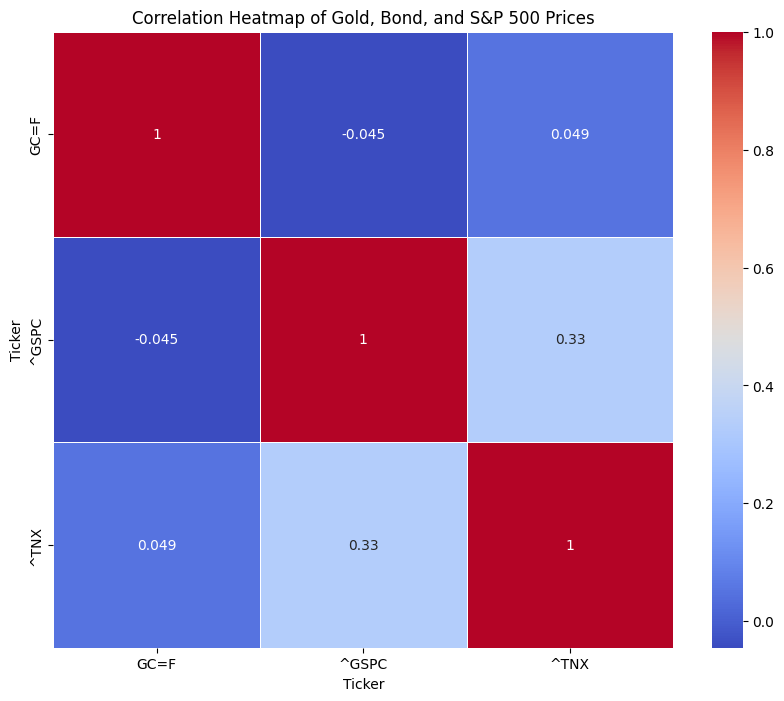

In [ ]:
import yfinance as yf
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Gold, US Treasury 10 Year Bond, S&P 500 ticker symbol
tickers = ['GC=F', '^TNX', '^GSPC']

# Get Data
data = yf.download(tickers, start='2013-04-28', end='2018-11-30')['Close']

# Delete missing values
data = data.dropna()

# Calculate correlations
correlation = data.corr()

# Create heat map
plt.figure(figsize=(10, 8))
sns.heatmap(correlation, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap of Gold, Bond, and S&P 500 Prices')
plt.show()

[*********************100%%**********************]  3 of 3 completed


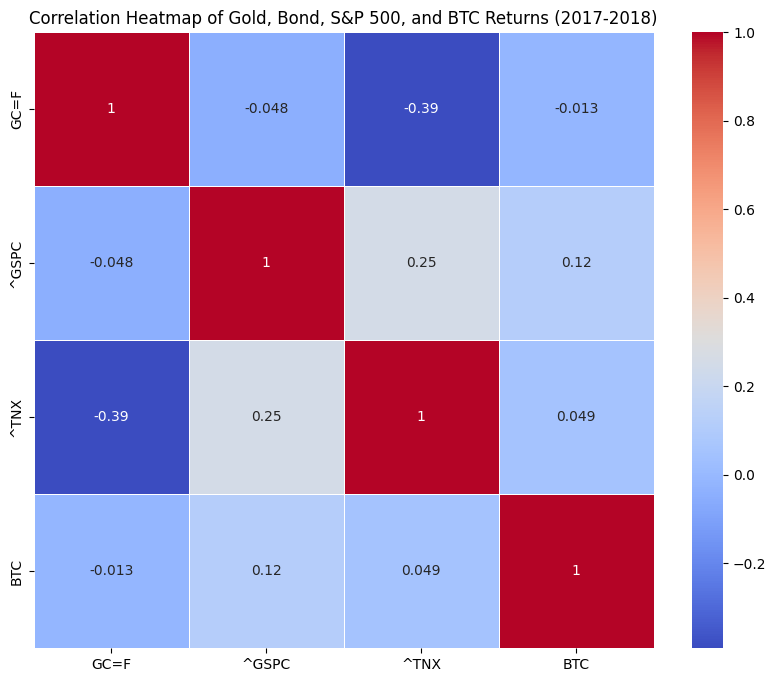

In [ ]:
import yfinance as yf
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
# Gold, US Treasury 10 Year Bond, S&P 500 ticker symbol
tickers = ['GC=F', '^TNX', '^GSPC']
# Data acquisition (time period changed from 2017)
market_data = yf.download(tickers, start='2017-01-01', end='2018-11-30')['Close']
# Delete missing values
market_data = market_data.dropna()
# Load data
crypto_data = pd.read_csv("/content/crypto-markets.csv")
# Remove 'slug' and 'name
crypto_data_cleaned = crypto_data.drop(columns=['slug', 'name'])
# Convert date index to datetime type
crypto_data_cleaned['date'] = pd.to_datetime(crypto_data_cleaned['date'])
# Extract only BTC data
btc_data = crypto_data_cleaned[crypto_data_cleaned['symbol'] == 'BTC']
# Formatted BTC data
btc_data = btc_data.set_index('date')['close'].rename('BTC')
# Get BTC data for the same time period (change the time period to from 2017)
btc_data = btc_data.loc['2017-01-01':'2018-11-30']
# Add BTC data
combined_data = market_data.join(btc_data, how='inner')
# Delete missing values
combined_data = combined_data.dropna()
# Calculate rate of change (logarithmic return)
returns = combined_data.pct_change().dropna()
# Calculate correlations
correlation = returns.corr()
# Create heat map
plt.figure(figsize=(10, 8))
sns.heatmap(correlation, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap of Gold, Bond, S&P 500, and BTC Returns (2017-2018)')
plt.show()